#1.Install & Import Libraries

In [1]:
# ============================================
# 1. Install & Import Libraries
# ============================================
!pip install numpy pandas matplotlib seaborn torch torchvision pillow ipython kagglehub

import os
import kagglehub
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import torch
import torch.nn.functional as F
from torchvision import models, transforms
from PIL import Image
from skimage.metrics import structural_similarity as ssim
from skimage.metrics import peak_signal_noise_ratio as psnr
from sklearn.metrics import confusion_matrix

print("All dependencies installed and imported successfully!")


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 34.9 MB/s eta 0:00:00
All dependencies installed and imported successfully!


# 2.Download & Prepare Dataset

In [2]:
#Upload kaggle.json file (contains your Kaggle API credentials)
from google.colab import files
files.upload()  # Upload your kaggle.json file


Saving kaggle.json to kaggle.json


{'kaggle.json': b'{"username":"alainngeukeu","key":"e22b3f855562e9fe7b7c75667735877b"}'}

In [3]:
#1.Create the .kaggle directory
#2.Move the uploaded kaggle.json file to the `.kaggle` directory
#3.Set proper permissions so that only you can read the file
!mkdir -p ~/.kaggle
!mv kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json


In [4]:

# Download latest version
# Here, the dataset is "nips-2017-adversarial-learning-development-set" from "google-brain"
path = kagglehub.dataset_download("google-brain/nips-2017-adversarial-learning-development-set")

print("Path to dataset files:", path)





#WHY THIS DATASET ?
#Link of the dataset : https://www.kaggle.com/datasets/google-brain/nips-2017-adversarial-learning-development-set
#Covers all key tasks – includes non-targeted attacks, targeted attacks, and defenses, matching real-world adversarial scenarios.
#Designed for robustness testing – allows evaluating how different attacks perform against various defense strategies.











100%|██████████| 146M/146M [00:00<00:00, 176MB/s]

Extracting files...


Path to dataset files: /root/.cache/kagglehub/datasets/google-brain/nips-2017-adversarial-learning-development-set/versions/2


In [5]:
# ---- Resolve correct dataset_path after kagglehub download ----
import os

def find_dataset_root(root_dir: str) -> str:
    """Return the directory that contains images.csv (searches recursively)."""
    # 1) direct hit?
    if os.path.isfile(os.path.join(root_dir, "images.csv")):
        return root_dir
    # 2) search subfolders
    for dirpath, dirnames, filenames in os.walk(root_dir):
        if "images.csv" in filenames:
            return dirpath
    raise FileNotFoundError(f"images.csv not found under: {root_dir}")

# Prefer the kagglehub cache path (works in Colab). If you run on Kaggle,
# you can still switch to /kaggle/input later.
dataset_path = find_dataset_root(path)
print("Resolved dataset_path:", dataset_path)

# (Optional) quick sanity check for the images folder
images_dir = os.path.join(dataset_path, "images")
print("Images folder exists:", os.path.isdir(images_dir))


Resolved dataset_path: /root/.cache/kagglehub/datasets/google-brain/nips-2017-adversarial-learning-development-set/versions/2
Images folder exists: True


#3.Data Exploration


== First 5 rows ==
            ImageId                                                URL  \
0  0c7ac4a8c9dfa802  https://c1.staticflickr.com/9/8540/28821627444...   
1  f43fbfe8a9ea876c  https://c1.staticflickr.com/9/8066/28892033183...   
2  4fc263d35a3ad3ee  https://c1.staticflickr.com/8/7378/27465801596...   
3  cc13c2bc5cdd1f44  https://c1.staticflickr.com/9/8864/28546467522...   
4  73a52afd2f818ed5  https://c1.staticflickr.com/6/5607/31066602702...   

         x1   y1        x2        y2  TrueLabel  TargetClass  \
0  0.000000  0.0  0.871838  1.000000        306          779   
1  0.250000  0.0  1.000000  0.599758        884          378   
2  0.333333  0.0  1.000000  1.000000        244          123   
3  0.000000  0.0  0.500000  0.750000        560          741   
4  0.489195  0.0  1.000000  0.750000        439          696   

                                  OriginalLandingURL  \
0  https://www.flickr.com/photos/gails_pictures/2...   
1    https://www.flickr.com/photos/bar

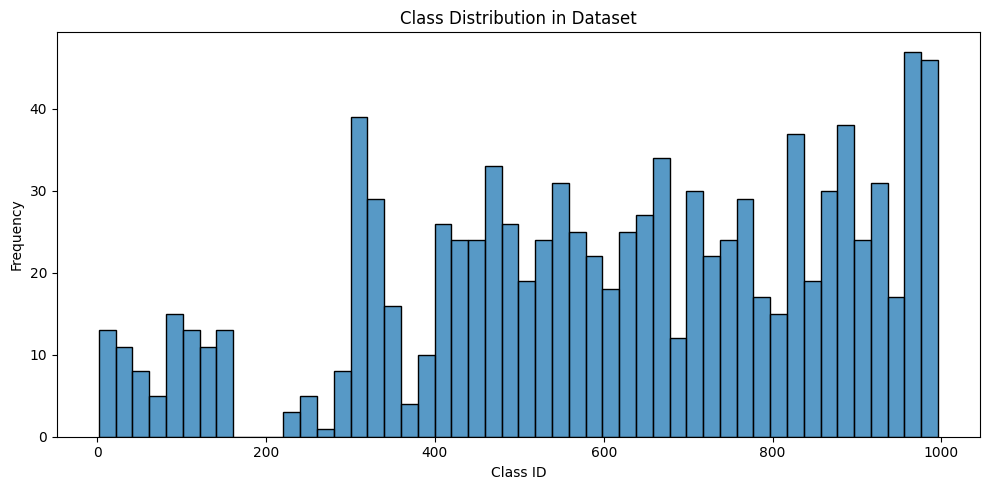

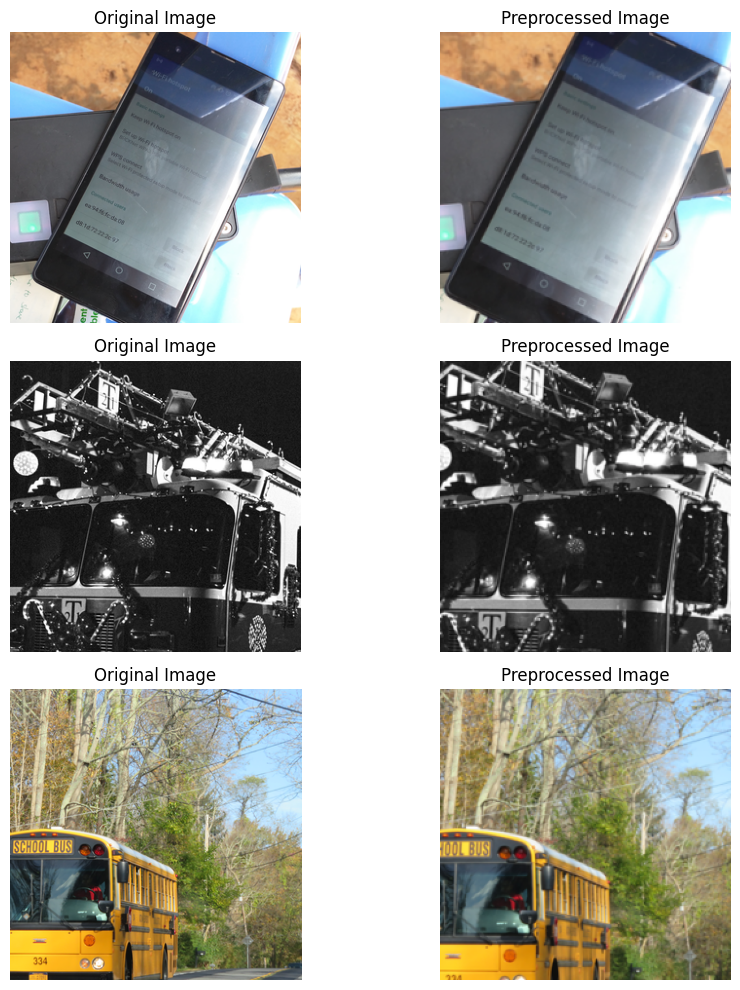

/usr/local/lib/python3.12/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=GoogLeNet_Weights.IMAGENET1K_V1`. You can also use `weights=GoogLeNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Downloading: "https://download.pytorch.org/models/googlenet-1378be20.pth" to /root/.cache/torch/hub/checkpoints/googlenet-1378be20.pth


100%|██████████| 49.7M/49.7M [00:01<00:00, 40.0MB/s]



Baseline Predictions on 3 samples:
- 64577d3916d6dafb → class 681, confidence 0.33
- d2cc2eabfc7bf54a → class 555, confidence 0.30
- 87a2147620d5e1cb → class 779, confidence 0.96


In [6]:
# ============================================
# 0) Imports (install lines optional)
# ============================================
# !pip install numpy pandas matplotlib seaborn torch torchvision pillow

import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

import torch
from torchvision import models, transforms
from PIL import Image

# ============================================
# 1) Load metadata
# ============================================
#dataset_path = "/kaggle/input/nips-2017-adversarial-learning-development-set"
# Convert Kaggle 1-based labels (1..1000) to PyTorch 0-based (0..999)

images_df = pd.read_csv(os.path.join(dataset_path, "images.csv"))

# Convert Kaggle 1-based labels (1..1000) to PyTorch 0-based (0..999)
images_df['TrueLabel0'] = images_df['TrueLabel'].astype(int) - 1

print("\n== First 5 rows ==")
print(images_df.head())
print("\n== DataFrame info ==")
print(images_df.info())


# ============================================
# 2) Integrity checks (schema/nulls/dups/labels/frequency)
# ============================================
print("\n== Column dtypes ==")
print(images_df.dtypes)

print("\n== Null counts ==")
print(images_df.isnull().sum())

print("\n== Duplicate identifier check ==")
print("Duplicate ImageId rows:", images_df["ImageId"].duplicated().sum())

print("\n== Label range & unique classes ==")
min_lab = images_df["TrueLabel"].min()
max_lab = images_df["TrueLabel"].max()
n_unique = images_df["TrueLabel"].nunique()
print(f"TrueLabel min={min_lab}, max={max_lab}, unique classes={n_unique}")

vc = images_df["TrueLabel"].value_counts()
print("\nTop-10 labels by count:\n", vc.head(10))
print("\nBottom-10 labels by count:\n", vc.tail(10))

# ============================================
# 3) File existence + quick readability spot-check
# ============================================
def id_to_path(image_id: str) -> str:
    return os.path.join(dataset_path, "images", f"{image_id}.png")

missing = sum(not os.path.isfile(id_to_path(iid)) for iid in images_df["ImageId"])
print("\nMissing image files:", missing)

sample_ids = images_df["ImageId"].sample(min(12, len(images_df)), random_state=7).tolist()
unreadable = 0
for iid in sample_ids:
    try:
        with Image.open(id_to_path(iid)) as im:
            im.verify()  # header check
    except Exception:
        unreadable += 1
print("Unreadable files in 12-sample check:", unreadable)

# ============================================
# 4) Class distribution plot
# ============================================
plt.figure(figsize=(10, 5))
sns.histplot(images_df["TrueLabel"], bins=50, kde=False)
plt.xlabel("Class ID")
plt.ylabel("Frequency")
plt.title("Class Distribution in Dataset")
plt.tight_layout()
plt.show()

# ============================================
# 5) Preprocessing utilities + preview
# ============================================
mean = [0.485, 0.456, 0.406]
std  = [0.229, 0.224, 0.225]

preprocess = transforms.Compose([
    transforms.Resize(256),
    transforms.CenterCrop(224),
    transforms.ToTensor(),
    transforms.Normalize(mean=mean, std=std),
])

def load_image(image_id: str) -> Image.Image:
    """Load RGB PIL image by ImageId."""
    return Image.open(id_to_path(image_id)).convert("RGB")

def preprocess_for_model(pil_img: Image.Image) -> torch.Tensor:
    """Return normalized tensor [1, C, H, W] suitable for model inference."""
    return preprocess(pil_img).unsqueeze(0)

def tensor_for_display(x_1chw: torch.Tensor) -> np.ndarray:
    """Denormalize [1,C,H,W] tensor and return HxWxC float image in [0,1] for plotting."""
    x = x_1chw.squeeze(0).clone().cpu()  # [C,H,W]
    for c, (m, s) in enumerate(zip(mean, std)):
        x[c] = x[c] * s + m
    x = x.clamp(0, 1).permute(1, 2, 0).numpy()
    return x

# Show 3 originals + their preprocessed (denormalized for viewing)
sample3 = images_df["ImageId"].sample(3, random_state=17).tolist()
fig, axes = plt.subplots(3, 2, figsize=(10, 10))
for i, img_id in enumerate(sample3):
    pil = load_image(img_id)
    x = preprocess_for_model(pil)
    axes[i, 0].imshow(pil)
    axes[i, 0].set_title("Original Image")
    axes[i, 0].axis("off")
    axes[i, 1].imshow(tensor_for_display(x))
    axes[i, 1].set_title("Preprocessed Image")
    axes[i, 1].axis("off")
plt.tight_layout()
plt.show()

# ============================================
# 6) Baseline model + quick predictions
# ============================================
# Using the legacy API to match your environment (warnings are OK)
model = models.googlenet(pretrained=True)
model.eval()

@torch.no_grad()
def predict_top1(x_1chw: torch.Tensor):
    """Return (predicted_class, confidence) from normalized [1,C,H,W] tensor."""
    logits = model(x_1chw)
    probs = torch.softmax(logits, dim=1)
    conf, cls = probs.max(dim=1)
    return int(cls.item()), float(conf.item())

print("\nBaseline Predictions on 3 samples:")
for img_id in sample3:
    pil = load_image(img_id)
    x = preprocess_for_model(pil)
    cls, conf = predict_top1(x)
    print(f"- {img_id} → class {cls}, confidence {conf:.2f}")


## 4. Load & Preprocess Images

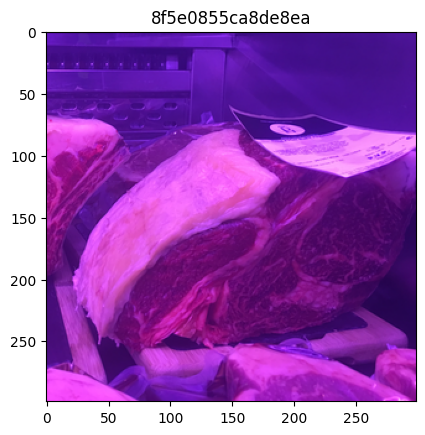

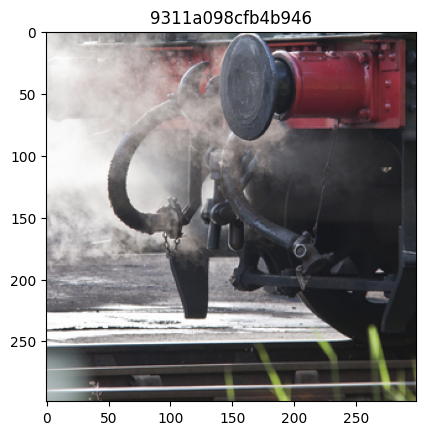

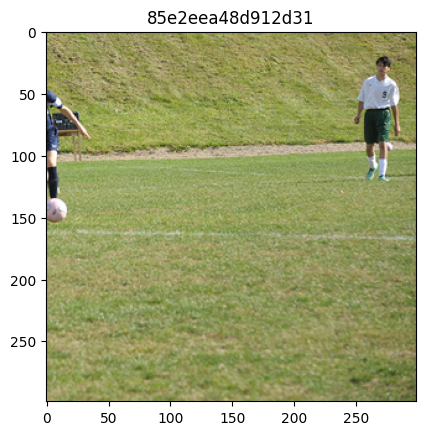

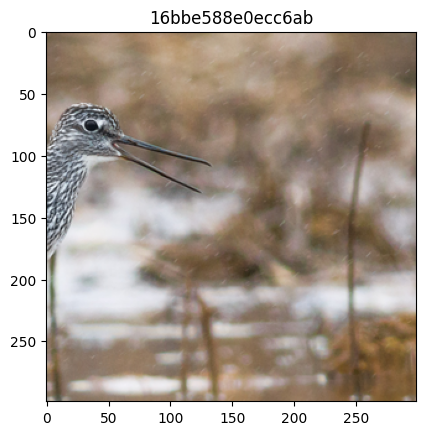

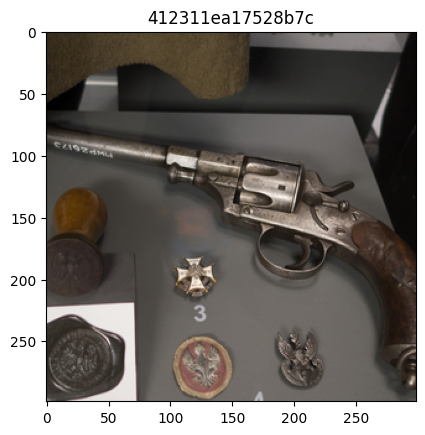

In [9]:

# Define preprocessing
mean = [0.485, 0.456, 0.406]
std = [0.229, 0.224, 0.225]
preprocess = transforms.Compose([
    transforms.Resize(256),
    transforms.CenterCrop(224),
    transforms.ToTensor(),
    transforms.Normalize(mean=mean, std=std)
])

# Function to load and preprocess an image
def load_image(image_filename):
    image_path = os.path.join(dataset_path, "images", image_filename + ".png")
    image = Image.open(image_path).convert("RGB")
    image_tensor = preprocess(image).unsqueeze(0)  # Add batch dimension
    return image, image_tensor

# Display 5 sample images
sample_images = images_df.sample(5)['ImageId'].values
for img in sample_images:
    image, _ = load_image(img)
    plt.imshow(image)
    plt.title(img)
    plt.show()


In [10]:
# Load Pre-trained Model (GoogleNet)
model = models.googlenet(pretrained=True)
model.eval()  # Sets the model to evaluation mode

# === STEP 1: Pixel-space preprocessing + helpers (paste right after model.eval()) ===
import torch
from torchvision import transforms

# Make sure model and tensors are on the same device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = model.to(device)

# 1) Preprocessing with NO normalization (keeps pixels in [0,1])
pre_no_norm = transforms.Compose([
    transforms.Resize(256),
    transforms.CenterCrop(224),
    transforms.ToTensor(),  # -> pixel tensor in [0,1]
])

# 2) Channel stats as tensors (we'll normalize INSIDE the forward pass)
_mean = torch.tensor([0.485, 0.456, 0.406]).view(1, 3, 1, 1).to(device)
_std  = torch.tensor([0.229, 0.224, 0.225]).view(1, 3, 1, 1).to(device)

def load_image_pix(image_id: str):
    """
    Return (PIL, x_pix[1,C,H,W]) where x_pix has pixel values in [0,1].
    Does NOT normalize. We'll normalize inside the model forward instead.
    """
    img_path = os.path.join(dataset_path, "images", f"{image_id}.png")
    pil = Image.open(img_path).convert("RGB")
    x_pix = pre_no_norm(pil).unsqueeze(0).to(device)  # [1,C,H,W] in [0,1]
    return pil, x_pix

def fwd_logits(model, x_pix: torch.Tensor) -> torch.Tensor:
    """
    Forward pass that normalizes INSIDE using ImageNet stats.
    x_pix must be in [0,1].
    """
    return model((x_pix - _mean) / _std)

@torch.no_grad()
def predict_top1_pix(model, x_pix: torch.Tensor):
    """
    Top-1 prediction + confidence from pixel-space input [1,C,H,W] in [0,1].
    """
    logits = fwd_logits(model, x_pix)
    probs = torch.softmax(logits, dim=1)
    conf, cls = probs.max(dim=1)
    return int(cls.item()), float(conf.item())

@torch.no_grad()
def top1_and_ptrue(model, x_pix, y_true):
    """
    x_pix: [1,C,H,W] in [0,1]; y_true: LongTensor shape [1]
    Returns (top1_class, top1_conf, p_true)
    """
    logits = fwd_logits(model, x_pix)          # normalize inside
    probs  = torch.softmax(logits, dim=1)
    conf, cls = probs.max(dim=1)               # max softmax (top-1)
    p_true = probs[0, y_true.item()].item()    # prob of the true label
    return int(cls.item()), float(conf.item()), float(p_true)



#Fast Gradient Sign Method Attack with Experiment on multiple values of eps

In [11]:
# === STEP 2: Pixel-space attacks (inputs in [0,1]), true-label loss ===
# Uses helpers from STEP 1: fwd_logits(model, x_pix)

import torch.nn.functional as F

def fgsm_pixel(model, x0_pix, y_true, eps):
    """
    x0_pix: [1,C,H,W] pixel tensor in [0,1]
    y_true: [1] LongTensor with the true class id
    eps:    float, e.g., 8/255
    """
    x = x0_pix.clone().detach().requires_grad_(True)
    logits = fwd_logits(model, x)
    loss = F.cross_entropy(logits, y_true)
    loss.backward()
    x_adv = (x + eps * x.grad.sign()).clamp(0, 1)
    return x_adv.detach()




# Basic Iterative Method (BIM) Attack with Experiment on multiple values of eps

In [12]:
def bim_pixel(model, x0_pix, y_true, eps, alpha, steps):
    """
    Basic Iterative Method (iterated FGSM) with L∞ projection in pixel space.
    alpha: step size (recommend alpha = eps/5)
    steps: number of iterations (e.g., 5 or 10)
    """
    x = x0_pix.clone().detach()
    for _ in range(steps):
        x.requires_grad_(True)
        logits = fwd_logits(model, x)
        loss = F.cross_entropy(logits, y_true)
        loss.backward()
        # gradient ascent on loss
        x = (x + alpha * x.grad.sign()).detach()
        # project to L∞ ball of radius eps around x0_pix
        delta = (x - x0_pix).clamp(-eps, eps)
        x = (x0_pix + delta).clamp(0, 1)
    return x.detach()


# Projected Gradient Descent (PGD) with Experiment on multiple values of eps

In [13]:

def pgd_pixel(model, x0_pix, y_true, eps, alpha, steps):
    """
    PGD with random start in the L∞ ball, pixel space.
    """
    # random uniform init in [-eps, eps], then clamp to [0,1]
    x = (x0_pix + torch.empty_like(x0_pix).uniform_(-eps, eps)).clamp(0, 1).detach()
    for _ in range(steps):
        x.requires_grad_(True)
        logits = fwd_logits(model, x)
        loss = F.cross_entropy(logits, y_true)
        loss.backward()
        x = (x + alpha * x.grad.sign()).detach()
        # project to L∞ ball and valid pixel range
        delta = (x - x0_pix).clamp(-eps, eps)
        x = (x0_pix + delta).clamp(0, 1)
    return x.detach()

In [14]:
# --- Milder schedule (keeps accuracy > 0) ---

def sched(eps: float):
    # alpha scales with eps; steps modest to avoid instant floor
    if eps <= 4/255:    # 0, 1/255, 2/255, 3/255, 4/255
        return eps/8, 3
    elif eps <= 8/255:  # 5/255..8/255
        return eps/8, 5
    else:               # 12/255..16/255
        return eps/8, 7


# Keep PGD *without* restarts for now to avoid over-strength
def pgd_pixel_no_restarts(model, x0_pix, y_true, eps, alpha, steps):
    return pgd_pixel(model, x0_pix, y_true, eps, alpha, steps)


/tmp/ipython-input-434681097.py:136: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0.02, 0.02, 0.98, 0.95])


Saved: Figure_2_1_5_BIM_fgsm_style_6frames.png


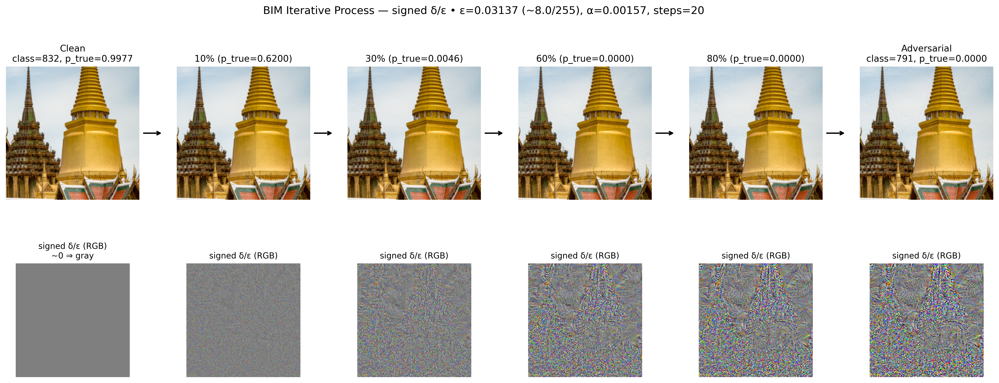

In [15]:
# ============================================
# BIM Storyboard — FGSM-style signed perturbation (RGB) with gradual buildup
# ============================================
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import gridspec
import torch
import torch.nn.functional as F

# --- helpers (assumes fwd_logits, load_image_pix, top1_and_ptrue exist) ---
def _np_img(x_1chw: torch.Tensor) -> np.ndarray:
    """[1,C,H,W] in [0,1] -> HxWxC float [0,1]"""
    return x_1chw.detach().clamp(0,1).squeeze(0).permute(1,2,0).cpu().numpy()

@torch.no_grad()
def _ptrue_for_frame(model, x_pix, y_true) -> float:
    logits = fwd_logits(model, x_pix)
    probs  = torch.softmax(logits, dim=1)
    return float(probs[0, y_true.item()].item())

def _run_bim_collect_images(model, x0, y_true, eps, alpha, steps):
    """Return all iterates [x^0 ... x^T] in pixel space [0,1]."""
    xs = [x0.clone().detach()]
    x = x0.clone().detach()
    for _ in range(steps):
        x.requires_grad_(True)
        logits = fwd_logits(model, x)
        loss = F.cross_entropy(logits, y_true)
        loss.backward()
        with torch.no_grad():
            x = (x + alpha * x.grad.sign()).clamp(0, 1)
            # project onto L∞ ball of radius ε around x0
            delta = (x - x0).clamp(-eps, eps)
            x = (x0 + delta).clamp(0, 1)
        xs.append(x.clone().detach())
    return xs

def _signed_rgb_delta_over_eps(x_t, x0, eps) -> np.ndarray:
    """
    Return FGSM-style signed perturbation visualization:
      vis_rgb in [-1,1] per channel, then mapped to [0,1] for display.
      Early iterations => near 0 (gray); later => saturates to vivid RGB.
    """
    if eps <= 0:
        # flat gray if ε=0
        HWC = _np_img(x0).shape
        return 0.5 * np.ones(HWC, dtype=np.float32)

    delta = (x_t - x0) / eps                       # [1,C,H,W], range about [-1,1]
    delta = delta.clamp(-1, 1).squeeze(0)          # [C,H,W]
    vis = delta.permute(1, 2, 0).cpu().numpy()     # HxWxC in [-1,1]
    vis01 = (vis + 1.0) / 2.0                      # map to [0,1] for RGB display
    return vis01

def plot_bim_fgsm_style_storyboard(
    image_id: str,
    eps: float = 8/255,
    steps: int = 20,
    frames=(0.00, 0.10, 0.30, 0.60, 0.80, 1.00),   # 6 frames; more early points -> clearer growth
    alpha_mode: str = "auto",                      # "auto" -> α = ε/steps (gradual build-up)
    alpha_manual: float | None = None,             # used only if alpha_mode != "auto"
    save_path: str = "Figure_2_1_5_BIM_fgsm_style_6frames.png",
    show: bool = True,
    dpi: int = 300
):
    """
    BIM storyboard with FGSM-style signed perturbation (RGB) row.
      Row 1: images + p_true (Clean → … → Adversarial)
      Row 2: signed δ/ε (RGB), like FGSM sign map but with magnitude revealing progress.
    """
    # --- choose α to get gradual growth of δ ---
    if alpha_mode == "auto":
        alpha = eps / steps        # reaches ε near the last iteration if gradients align
    else:
        alpha = alpha_manual if alpha_manual is not None else (eps / 10)

    # --- load input and label ---
    pil, x0 = load_image_pix(image_id)
    y0 = int(images_df.loc[images_df["ImageId"] == image_id, "TrueLabel0"].values[0])
    y_true = torch.tensor([y0], dtype=torch.long, device=x0.device)

    # --- run BIM trajectory ---
    iters = _run_bim_collect_images(model, x0, y_true, eps, alpha, steps)
    T = steps
    frame_idx = [max(0, min(T, int(round(f*T)))) for f in frames]
    n = len(frame_idx)

    # --- layout ---
    fig = plt.figure(figsize=(3.6*n, 7.2), dpi=dpi)
    gs = gridspec.GridSpec(2, n, height_ratios=[3.2, 2.2], hspace=0.34, wspace=0.28)

    # ---------- Row 1: images ----------
    for c, t in enumerate(frame_idx):
        ax = fig.add_subplot(gs[0, c])
        ax.imshow(_np_img(iters[t]))

        if t == 0:
            cls, conf, ptrue = top1_and_ptrue(model, x0, y_true)
            title = f"Clean\nclass={cls}, p_true={ptrue:.4f}"
        elif t == T:
            cls, conf, ptrue = top1_and_ptrue(model, iters[t], y_true)
            title = f"Adversarial\nclass={cls}, p_true={ptrue:.4f}"
        else:
            perc = int(round(100*t/T))
            ptrue = _ptrue_for_frame(model, iters[t], y_true)
            title = f"{perc}% (p_true={ptrue:.4f})"

        ax.set_title(title, fontsize=11)
        ax.axis("off")

        # arrows: left → right
        if c < n-1:
            ax.annotate(
                "",
                xy=(1.18, 0.5),  xycoords="axes fraction",
                xytext=(1.02, 0.5), textcoords="axes fraction",
                arrowprops=dict(arrowstyle="->", lw=1.6, color="black")
            )

    # ---------- Row 2: FGSM-style signed δ/ε (RGB) ----------
    for c, t in enumerate(frame_idx):
        ax = fig.add_subplot(gs[1, c])
        vis_rgb01 = _signed_rgb_delta_over_eps(iters[t], x0, eps)
        ax.imshow(vis_rgb01)                           # RGB; no colormap
        if t == 0:
            ax.set_title("signed δ/ε (RGB)\n~0 ⇒ gray", fontsize=10)
        else:
            ax.set_title("signed δ/ε (RGB)", fontsize=10)
        ax.axis("off")

    # ---------- title & save ----------
    fig.suptitle(
        f"BIM Iterative Process — signed δ/ε • ε={eps:.5f} (~{eps*255:.1f}/255), α={alpha:.5f}, steps={steps}",
        fontsize=13, y=0.985
    )
    plt.tight_layout(rect=[0.02, 0.02, 0.98, 0.95])

    if save_path:
        plt.savefig(save_path, dpi=dpi, bbox_inches="tight", facecolor="white")
        print(f"Saved: {save_path}")
    if show:
        plt.show()

# ==== Quick demo (reproducible) ====
demo_id = images_df['ImageId'].sample(1, random_state=42).item()
plot_bim_fgsm_style_storyboard(
    image_id=demo_id,
    eps=8/255,
    steps=20,                                   # more steps → smoother progression
    frames=(0.00, 0.10, 0.30, 0.60, 0.80, 1.00),
    alpha_mode="auto",                           # α = ε/steps (gradual)
    save_path="Figure_2_1_5_BIM_fgsm_style_6frames.png",
    show=True
)


In [16]:
# ============================================
# PGD storyboard (FGSM-style δ/ε, with proper arrows & label placement)
# ============================================
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import gridspec
import torch
import torch.nn.functional as F

# ---------- helpers ----------
def _np_img(x_1chw: torch.Tensor) -> np.ndarray:
    return x_1chw.detach().clamp(0,1).squeeze(0).permute(1,2,0).cpu().numpy()

@torch.no_grad()
def _ptrue(model, x_pix, y_true) -> float:
    probs = torch.softmax(fwd_logits(model, x_pix), dim=1)
    return float(probs[0, y_true.item()].item())

def _signed_rgb_delta_over_eps(x_t, x0, eps) -> np.ndarray:
    """FGSM-style signed δ/ε visualization in RGB ([-1,1] mapped to [0,1])."""
    if eps <= 0:
        H, W, C = _np_img(x0).shape
        return 0.5 * np.ones((H, W, C), dtype=np.float32)
    delta = (x_t - x0) / eps
    delta = delta.clamp(-1, 1).squeeze(0)        # [C,H,W]
    vis   = delta.permute(1, 2, 0).cpu().numpy() # HxWxC in [-1,1]
    return (vis + 1.0) / 2.0                     # → [0,1]

def _make_random_init_scaled(x0, eps, scale=1.25):
    delta = torch.empty_like(x0).uniform_(-eps, eps)
    delta = (scale * delta).clamp(-eps, eps)
    return (x0 + delta).clamp(0, 1).detach()

def _run_pgd_collect(model, x0, y_true, eps, steps, alpha=None, random_init_scale=1.25):
    if alpha is None:
        alpha = eps / 8.0
    x = _make_random_init_scaled(x0, eps, scale=random_init_scale)
    x_init = x.clone().detach()
    xs, losses, p_trues = [], [], []
    for _ in range(steps):
        x.requires_grad_(True)
        logits = fwd_logits(model, x)
        loss = F.cross_entropy(logits, y_true)
        loss.backward()
        with torch.no_grad():
            x = x + alpha * x.grad.sign()
            delta = (x - x0).clamp(-eps, eps)
            x = (x0 + delta).clamp(0, 1)
            logits_t = fwd_logits(model, x)
            probs_t  = torch.softmax(logits_t, dim=1)
            p_true_t = float(probs_t[0, y_true.item()].item())
        xs.append(x.clone().detach())
        losses.append(float(F.cross_entropy(logits_t, y_true).item()))
        p_trues.append(p_true_t)
    return x_init, xs, np.array(losses), np.array(p_trues)

# ---------- final storyboard ----------
def plot_pgd_storyboard_final(
    image_id: str,
    eps: float = 8/255,
    steps: int = 20,
    frames=(0.20, 0.40, 0.60, 0.80, 1.00),
    alpha: float | None = None,
    random_init_scale: float = 1.25,
    save_path: str = "BildPGD.png",
    show: bool = True,
    dpi: int = 300
):
    pil, x0 = load_image_pix(image_id)
    y0 = int(images_df.loc[images_df["ImageId"] == image_id, "TrueLabel0"].values[0])
    y_true = torch.tensor([y0], dtype=torch.long, device=x0.device)

    x_init, xs, losses, p_trues = _run_pgd_collect(model, x0, y_true, eps, steps, alpha, random_init_scale)

    T = steps
    idxs = [max(1, int(round(T*f))) for f in frames]
    panels = [("Clean",       x0, None),
              ("Random init", x_init, None)] + \
             [(f"{int(100*f)}%", xs[i-1], i) for f, i in zip(frames, idxs)]

    n = len(panels)
    fig = plt.figure(figsize=(3.3*n, 7.6), dpi=dpi)
    gs  = gridspec.GridSpec(2, n, height_ratios=[3.2, 2.2], hspace=0.36, wspace=0.30)

    cls0, conf0, ptrue0 = top1_and_ptrue(model, x0, y_true)
    clsT, confT, ptrueT = top1_and_ptrue(model, panels[-1][1], y_true)

    # ---------- Row 1: images ----------
    top_axes = []
    for c, (name, x_t, t_idx) in enumerate(panels):
        ax = fig.add_subplot(gs[0, c]); top_axes.append(ax)
        ax.imshow(_np_img(x_t))
        if name == "Clean":
            title = f"Clean\nclass={cls0}, p_true={ptrue0:.4f}"
        elif name == "Random init":
            for sp in ax.spines.values():
                sp.set_edgecolor("#D62728"); sp.set_linewidth(4.0)
            title = f"Random init\n(p_true={_ptrue(model, x_t, y_true):.4f})"
        elif name == "100%":
            title = f"Adversarial\nclass={clsT}, p_true={ptrueT:.4f}"
        else:
            title = f"{name}\n(p_true={_ptrue(model, x_t, y_true):.4f})"
        ax.set_title(title, fontsize=11)
        ax.axis("off")

    # ---------- Arrows + label (fixed placement BELOW images) ----------
    # ---------- Arrows + label (fixed placement BELOW images) ----------
    for c in range(n - 1):
        ax_anchor = top_axes[c]
        axL, axR  = top_axes[c], top_axes[c+1]
        bb1 = axL.get_position(fig); bb2 = axR.get_position(fig)
        y_center = 0.5 * (bb1.y0 + bb1.y1)
        x1 = bb1.x1 + 0.006; x2 = bb2.x0 - 0.006
        ax_anchor.annotate(
            "",
            xy=(x2, y_center), xycoords=fig.transFigure,
            xytext=(x1, y_center), textcoords=fig.transFigure,
            arrowprops=dict(arrowstyle="->", lw=(3.0 if c == 0 else 2.2), color="black"),
            annotation_clip=False, zorder=50
        )
        if c == 0:
            # NEW vertical offset far below images
            label_y = bb1.y0 - 0.065
            fig.text(
                (x1 + x2) / 2.0, label_y,
                r"$\delta \sim \mathcal{U}[-\epsilon,\epsilon]$",
                ha="center", va="top", fontsize=10,
                bbox=dict(facecolor="white", alpha=0.95,
                          edgecolor="black", lw=0.5,
                          boxstyle="round,pad=0.25"),
                transform=fig.transFigure,
                zorder=200
            )


    # ---------- Row 2: signed δ/ε ----------
    for c, (name, x_t, t_idx) in enumerate(panels):
        ax = fig.add_subplot(gs[1, c])
        vis_rgb01 = _signed_rgb_delta_over_eps(x_t, x0, eps)
        ax.imshow(vis_rgb01)
        if name == "Clean":
            ax.set_title("signed δ/ε (RGB)\n~0 ⇒ gray", fontsize=10)
        else:
            ax.set_title("signed δ/ε (RGB)", fontsize=10)
        if name == "Random init":
            for sp in ax.spines.values():
                sp.set_edgecolor("#D62728"); sp.set_linewidth(2.0)
        ax.axis("off")

    fig.suptitle(
        f"PGD Iterative Process — δ/ε • ε={eps:.5f}, steps={T}",
        fontsize=13, y=0.985
    )
    plt.tight_layout(rect=[0.02, 0.02, 0.98, 0.95])

    if save_path:
        plt.savefig(save_path, dpi=dpi, bbox_inches="tight", facecolor="white")
        print(f"Saved: {save_path}")
    if show:
        plt.show()


[FAST DEMO] ImageId=da4f4d6944d93ae0


/tmp/ipython-input-3903248117.py:154: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0.02, 0.02, 0.98, 0.95])


Saved: BildPGD.png


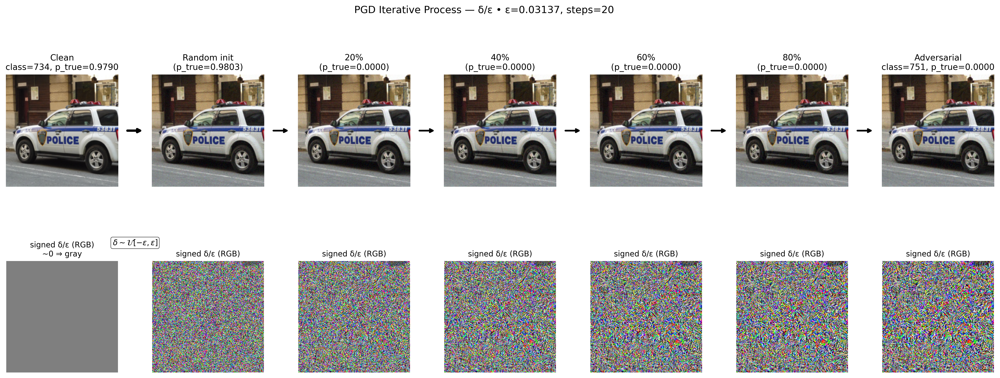

[PREFILTER DEMO] Picked ImageId=afa0f88aaab03427 with clean p_true=0.965
Saved: BildPGD_prefilter.png


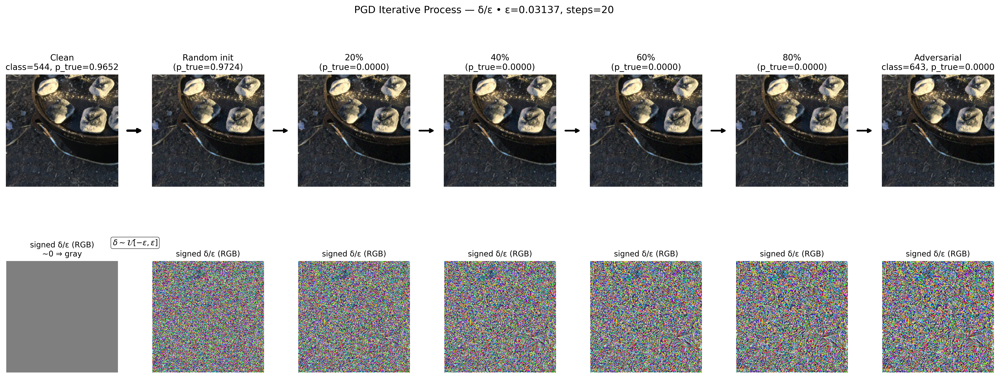

Saved: BildPGD.png and BildPGD_prefilter.png


In [17]:
# ============================
# PGD storyboard — DEMO
# ============================

# Option A (fast): pick one image deterministically and plot
demo_id = images_df["ImageId"].sample(1, random_state=2026).item()
print(f"[FAST DEMO] ImageId={demo_id}")

plot_pgd_storyboard_final(
    image_id=demo_id,
    eps=8/255,
    steps=20,                        # enough to show gradual change
    frames=(0.20, 0.40, 0.60, 0.80, 1.00),
    alpha=None,                      # uses α = ε/8 inside
    random_init_scale=1.25,          # mild random init → avoids instant collapse
    save_path="BildPGD.png",
    show=True
)

# ------------------------------------------
# Option B (still quick): pre-filter for a high-confidence clean image
# (This improves chances of a nice gradual p_true curve without heavy searching.)
import numpy as np
best_id, best_p = None, -1.0
candidates = images_df["ImageId"].sample(20, random_state=77).tolist()
for iid in candidates:
    _, x0 = load_image_pix(iid)
    y0 = int(images_df.loc[images_df["ImageId"] == iid, "TrueLabel0"].values[0])
    y_true = torch.tensor([y0], dtype=torch.long, device=x0.device)
    _, _, p = top1_and_ptrue(model, x0, y_true)
    if p > best_p:
        best_id, best_p = iid, p

print(f"[PREFILTER DEMO] Picked ImageId={best_id} with clean p_true={best_p:.3f}")

plot_pgd_storyboard_final(
    image_id=best_id,
    eps=8/255,
    steps=20,
    frames=(0.20, 0.40, 0.60, 0.80, 1.00),
    alpha=None,                      # α = ε/8 inside (gentle)
    random_init_scale=1.25,
    save_path="BildPGD_prefilter.png",
    show=True
)

print("Saved: BildPGD.png and BildPGD_prefilter.png")


# Analysis of Class Frequency Impact on Adversarial Robustness


In [18]:
# --- Adaptive bucketing: split labels by count thirds ---
# (requires numpy as np; you already imported it)
label_counts = images_df['TrueLabel'].value_counts()

counts = label_counts.values.astype(float)

# If there are fewer than 3 unique count values, quantiles can collapse.
# We'll guard for that with a small epsilon and a fallback.
if len(np.unique(counts)) >= 3:
    q1, q2 = np.quantile(counts, [1/3, 2/3])
else:
    # crude split when distribution is very flat
    q1, q2 = np.percentile(counts, [33, 67])

def bucket_by_count(lbl):
    c = label_counts.get(lbl, 0)
    if c <= q1:
        return 'Rare'
    elif c <= q2:
        return 'Medium'
    else:
        return 'Frequent'

images_df['FrequencyBucket'] = images_df['TrueLabel'].map(bucket_by_count)

# Fallback if any bucket ends up empty (edge cases)
vc = images_df['FrequencyBucket'].value_counts()
if ('Frequent' not in vc) or (vc['Frequent'] == 0) or ('Medium' not in vc) or (vc['Medium'] == 0):
    def bucket_fallback(lbl):
        c = label_counts.get(lbl, 0)
        if c <= 1:   return 'Rare'
        elif c <= 3: return 'Medium'
        else:        return 'Frequent'
    images_df['FrequencyBucket'] = images_df['TrueLabel'].map(bucket_fallback)

print("Bucket counts after adaptive bucketing:")
print(images_df['FrequencyBucket'].value_counts())




Bucket counts after adaptive bucketing:
FrequencyBucket
Frequent    540
Medium      253
Rare        207
Name: count, dtype: int64


In [ ]:
# 7.1.5 – Helper to fetch the true label for a given ImageId
def get_label0(img_id):
    return int(images_df.loc[images_df["ImageId"] == img_id, "TrueLabel0"].values[0])



In [19]:
# 7.2 – Run model clean vs. adversarial on every image and record results

def collect_predictions(attack_fn, epsilon, model, sample_ids):
    rows = []
    for img_id in sample_ids:
        true_label1 = int(images_df.loc[images_df['ImageId'] == img_id, 'TrueLabel'].item())   # 1-based (for display)
        true_label0 = int(images_df.loc[images_df['ImageId'] == img_id, 'TrueLabel0'].item())  # 0-based (for model)
        bucket      = images_df.loc[images_df['ImageId'] == img_id, 'FrequencyBucket'].item()

        # load pixel tensor in [0,1]
        _, x_pix = load_image_pix(img_id)
        y_true = torch.tensor([true_label0], dtype=torch.long, device=x_pix.device)

        # clean prediction (also record p(true))
        pred_c, conf_c, ptrue_c = top1_and_ptrue(model, x_pix, y_true)

        # adversarial prediction (pixel-space attack)
        x_adv = attack_fn(model, x_pix, y_true, epsilon)
        pred_a, conf_a, ptrue_a = top1_and_ptrue(model, x_adv, y_true)

        rows.append({
            'ImageId': img_id,
            'TrueLabel':  true_label1,
            'TrueLabel0': true_label0,   # <-- use this for comparisons
            'FrequencyBucket': bucket,
            'PredClean': pred_c,
            'ConfClean': conf_c,
            'PTrueClean': ptrue_c,
            'PredAdv':   pred_a,
            'ConfAdv':   conf_a,
            'PTrueAdv':  ptrue_a
        })


    return pd.DataFrame(rows)




In [20]:
# 7.2.1 – Collect predictions for all attacks & ε’s (using stratified sampling)

# === REPLACE this block in 7.2.1 with pixel-space attacks ===
attack_fns = {
    'FGSM': lambda model, x_pix, y, eps: fgsm_pixel(model, x_pix, y, eps),
    'BIM':  lambda model, x_pix, y, eps: (lambda a_s: bim_pixel(model, x_pix, y, eps, alpha=a_s[0], steps=a_s[1]))(sched(eps)),
    'PGD':  lambda model, x_pix, y, eps: (lambda a_s: pgd_pixel_no_restarts(model, x_pix, y, eps, alpha=a_s[0], steps=a_s[1]))(sched(eps)),
}



epsilons = [0.0, 1/255, 2/255, 3/255, 4/255, 8/255, 12/255]


# ─── Stratified Sampling Block ─────────────────────────────────────────────────
# We want a quick, representative subset of images from each frequency bucket
# so that even rare classes are included in our prototype run.

# 1. Separate image IDs by bucket:
ids_rare = images_df.loc[images_df.FrequencyBucket == 'Rare',   'ImageId']
ids_med  = images_df.loc[images_df.FrequencyBucket == 'Medium', 'ImageId']
ids_freq = images_df.loc[images_df.FrequencyBucket == 'Frequent','ImageId']

# 2. Decide how many to draw from each bucket (or take all if fewer available):
#    - Rare bucket often has the most classes, so we sample up to 100
#    - Medium and Frequent we sample up to 50 each
n_rare   = min(100, len(ids_rare))
n_med    = min( 50, len(ids_med))
n_freq   = min( 50, len(ids_freq))

# 3. Perform the random sampling within each bucket:
sub_rare = ids_rare.sample(n_rare, random_state=1)
sub_med  = ids_med.sample(n_med,   random_state=1)
sub_freq = ids_freq.sample(n_freq, random_state=1)

# 4. Combine into one list of IDs for our subset run
image_ids = pd.concat([sub_rare, sub_med, sub_freq]).tolist()
print(f"Stratified sample sizes → Rare: {n_rare}, Medium: {n_med}, Frequent: {n_freq}")
# ────────────────────────────────────────────────────────────────────────────────

all_results = []
for attack_name, fn in attack_fns.items():
    for eps in epsilons:
        print(f"Running {attack_name} @ ε={eps:.5f} on {len(image_ids)} images")
        df = collect_predictions(fn, eps, model, image_ids)
        df['Attack']  = attack_name
        df['Epsilon'] = eps
        all_results.append(df)

# Combine all the partial results into one DataFrame for analysis
attack_results_all = pd.concat(all_results, ignore_index=True)
print("\nCombined results head:")
print(attack_results_all.head())




Stratified sample sizes → Rare: 100, Medium: 50, Frequent: 50
Running FGSM @ ε=0.00000 on 200 images
Running FGSM @ ε=0.00392 on 200 images
Running FGSM @ ε=0.00784 on 200 images
Running FGSM @ ε=0.01176 on 200 images
Running FGSM @ ε=0.01569 on 200 images
Running FGSM @ ε=0.03137 on 200 images
Running FGSM @ ε=0.04706 on 200 images
Running BIM @ ε=0.00000 on 200 images
Running BIM @ ε=0.00392 on 200 images
Running BIM @ ε=0.00784 on 200 images
Running BIM @ ε=0.01176 on 200 images
Running BIM @ ε=0.01569 on 200 images
Running BIM @ ε=0.03137 on 200 images
Running BIM @ ε=0.04706 on 200 images
Running PGD @ ε=0.00000 on 200 images
Running PGD @ ε=0.00392 on 200 images
Running PGD @ ε=0.00784 on 200 images
Running PGD @ ε=0.01176 on 200 images
Running PGD @ ε=0.01569 on 200 images
Running PGD @ ε=0.03137 on 200 images
Running PGD @ ε=0.04706 on 200 images

Combined results head:
            ImageId  TrueLabel  TrueLabel0 FrequencyBucket  PredClean  \
0  604b54a3b7424d9b        939      

  Attack FrequencyBucket      Drop
0    BIM        Frequent  0.655468
1    BIM          Medium  0.633470
2    BIM            Rare  0.584480
3   FGSM        Frequent  0.619426
4   FGSM          Medium  0.592884
5   FGSM            Rare  0.549226
6    PGD        Frequent  0.655506
7    PGD          Medium  0.633475
8    PGD            Rare  0.584491


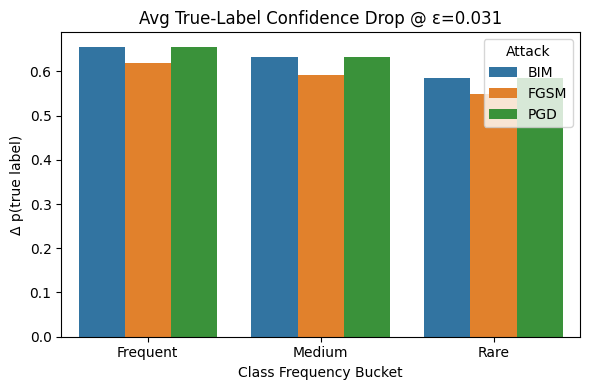

In [21]:
# ─── Cell 7.3 – Avg Confidence Drop per Bucket & Attack @ ε = 8/255 ────────────────

import seaborn as sns
import matplotlib.pyplot as plt

eps_to_plot = 8/255

# robust float filter (don't use exact equality)
mask = np.isclose(attack_results_all['Epsilon'].astype(float), float(eps_to_plot), atol=1e-9)

conf_drop_true = (
    attack_results_all.loc[mask]
      .assign(Drop=lambda df: df['PTrueClean'] - df['PTrueAdv'])  # positive = drop
      .groupby(['Attack','FrequencyBucket'], as_index=False)['Drop'].mean()
)

print(conf_drop_true)  # sanity check

plt.figure(figsize=(6,4))
sns.barplot(
    data=conf_drop_true,
    x='FrequencyBucket', y='Drop', hue='Attack'
)
plt.title(f"Avg True-Label Confidence Drop @ ε={eps_to_plot:.3f}")
plt.ylabel("Δ p(true label)")
plt.xlabel("Class Frequency Bucket")
plt.ylim(0, None)
plt.legend(title="Attack")
plt.tight_layout()
plt.show()


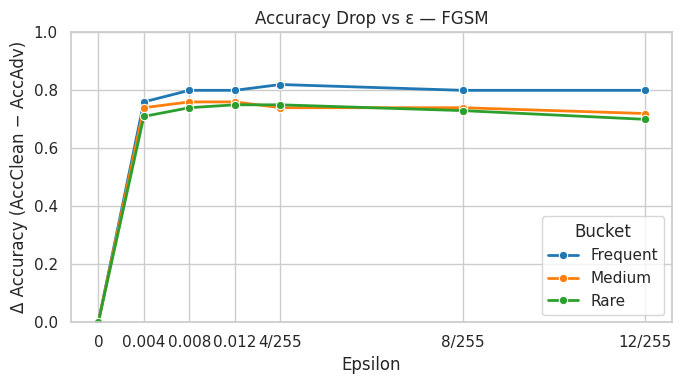

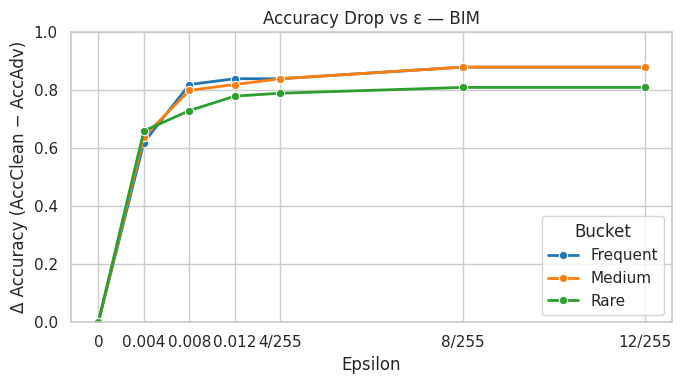

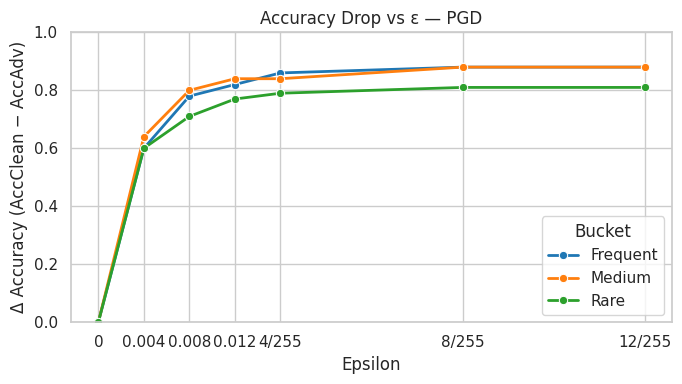

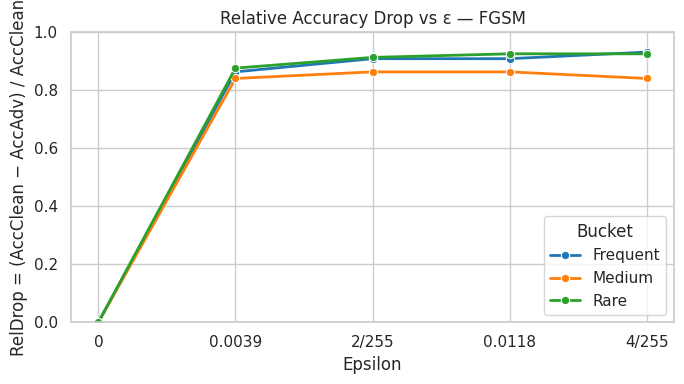

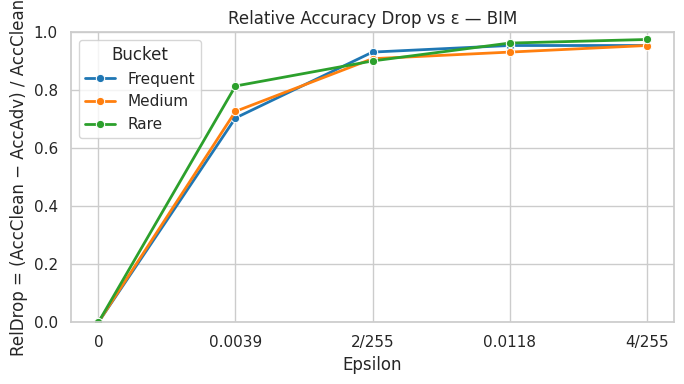

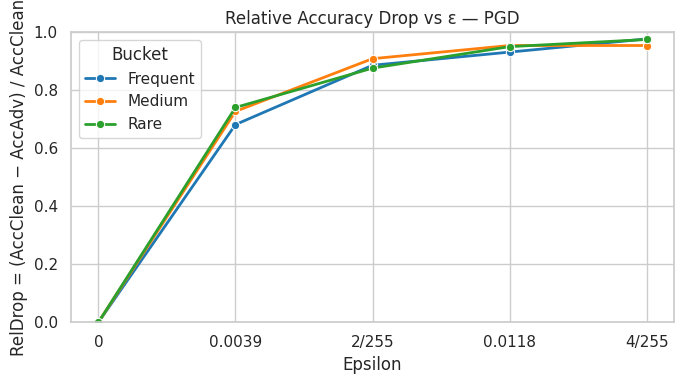

In [22]:
# === Three separate, colorful plots: one per attack; hue = bucket ===
# --- Build summary for Accuracy Drop vs ε (needed for the plots) ---
tmp = (
    attack_results_all
      .assign(
          Eps=lambda df: df['Epsilon'].astype(float),
          CorrectClean=lambda df: df.PredClean == df.TrueLabel0,
          CorrectAdv =lambda df: df.PredAdv   == df.TrueLabel0
      )
)

summary = (
    tmp.groupby(['Attack','Eps','FrequencyBucket'])
       .agg(
           AccClean=('CorrectClean','mean'),
           AccAdv  =('CorrectAdv','mean'),
           N=('ImageId','size')
       )
       .reset_index()
)

summary['Drop'] = summary['AccClean'] - summary['AccAdv']  # ΔAccuracy

import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

sns.set_theme(style="whitegrid")

# Ensure epsilon is ordered and consistent on the x-axis
eps_order = sorted(summary['Eps'].unique())
summary = summary.sort_values('Eps')
summary['Eps'] = pd.Categorical(summary['Eps'], categories=eps_order, ordered=True)

# Fix bucket order & a consistent, colorful palette across figures
bucket_order = ["Frequent", "Medium", "Rare"]
palette = {
    "Frequent": sns.color_palette("tab10")[0],  # blue
    "Medium":   sns.color_palette("tab10")[1],  # orange
    "Rare":     sns.color_palette("tab10")[2],  # green
}

# Pretty labels for common eps values; fallback to numeric
def eps_label(e):
    if np.isclose(float(e), 0): return "0"
    if np.isclose(float(e), 4/255): return "4/255"
    if np.isclose(float(e), 8/255): return "8/255"
    if np.isclose(float(e),12/255): return "12/255"
    if np.isclose(float(e),16/255): return "16/255"
    return f"{float(e):.3f}"

xtick_labels = [eps_label(e) for e in eps_order]

# Make one figure per attack
for atk in ["FGSM", "BIM", "PGD"]:
    df_atk = summary[summary["Attack"] == atk]

    plt.figure(figsize=(7,4))
    sns.lineplot(
        data=df_atk,
        x="Eps", y="Drop",
        hue="FrequencyBucket",
        hue_order=bucket_order,
        palette=palette,
        marker="o",
        linewidth=2
    )
    plt.title(f"Accuracy Drop vs ε — {atk}")
    plt.ylabel("Δ Accuracy (AccClean − AccAdv)")
    plt.xlabel("Epsilon")
    plt.ylim(0, 1.0)
    plt.xticks(ticks=eps_order, labels=xtick_labels)
    plt.legend(title="Bucket", loc="best")
    plt.tight_layout()
    plt.show()
    # plt.savefig(f"acc_drop_{atk.lower()}.png", dpi=300, bbox_inches="tight")  # <- uncomment to save

    # === 7.4 — Relative Accuracy Drop vs ε (small ε only), one figure per attack ===
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

# Build summary with clean/adv accuracy
tmp = (
    attack_results_all
      .assign(
          Eps=lambda df: df['Epsilon'].astype(float),
          CorrectClean=lambda df: df.PredClean == df.TrueLabel0,  # uses 0-based labels
          CorrectAdv =lambda df: df.PredAdv   == df.TrueLabel0
      )
)

summary = (
    tmp.groupby(['Attack','Eps','FrequencyBucket'])
       .agg(
           AccClean=('CorrectClean','mean'),
           AccAdv  =('CorrectAdv','mean'),
           N=('ImageId','size')
       )
       .reset_index()
)

# Relative drop = fraction of clean accuracy lost
summary['RelDrop'] = (summary['AccClean'] - summary['AccAdv']) / summary['AccClean'].replace(0, np.nan)

# Keep only small epsilons (≤ 4/255)
max_eps = 4/255
summary = summary[summary['Eps'] <= max_eps].copy()

# Order ε on x-axis and buckets in legend
eps_order = sorted(summary['Eps'].unique())
summary['Eps'] = pd.Categorical(summary['Eps'], categories=eps_order, ordered=True)
bucket_order = ["Frequent", "Medium", "Rare"]
palette = {
    "Frequent": sns.color_palette("tab10")[0],  # blue
    "Medium":   sns.color_palette("tab10")[1],  # orange
    "Rare":     sns.color_palette("tab10")[2],  # green
}

# Pretty ε labels
def eps_label(e):
    e = float(e)
    if np.isclose(e, 0):       return "0"
    if np.isclose(e, 2/255):   return "2/255"
    if np.isclose(e, 4/255):   return "4/255"
    return f"{e:.4f}"

xtick_labels = [eps_label(e) for e in eps_order]

# One colorful figure per attack; three lines (Frequent/Medium/Rare)
sns.set_theme(style="whitegrid")
for atk in ["FGSM", "BIM", "PGD"]:
    df_atk = summary[summary["Attack"] == atk]
    plt.figure(figsize=(7,4))
    sns.lineplot(
        data=df_atk,
        x="Eps", y="RelDrop",
        hue="FrequencyBucket", hue_order=bucket_order,
        palette=palette, marker="o", linewidth=2
    )
    plt.title(f"Relative Accuracy Drop vs ε — {atk}")
    plt.ylabel("RelDrop = (AccClean − AccAdv) / AccClean")
    plt.xlabel("Epsilon")
    plt.ylim(0, 1.0)
    plt.xticks(ticks=eps_order, labels=xtick_labels)
    plt.legend(title="Bucket", loc="best")
    plt.tight_layout()
    plt.show()



In [23]:
# ─── Cell 7.5 – Generalized Accuracy Summary ────────────────────────────────────

# Build summary table
summary2 = (
    attack_results_all
      .assign(
        CorrectClean=lambda df: df.PredClean == df.TrueLabel0,   # CHANGED
        CorrectAdv=lambda df: df.PredAdv   == df.TrueLabel0      # CHANGED
        )


      .groupby(['Attack','Epsilon','FrequencyBucket'])
      .agg(
         Samples  =('TrueLabel','size'),
         AccClean =('CorrectClean','mean'),
         AccAdv   =('CorrectAdv','mean')
      )
      .reset_index()
)
summary2['Drop'] = summary2['AccClean'] - summary2['AccAdv']

# ➜ ADD THIS LINE RIGHT BELOW:
summary2['RelDrop'] = (summary2['Drop'] / summary2['AccClean'].clip(lower=1e-9)).clip(0, 1)

# Optional: quick peek
print(
    summary2[['Attack','Epsilon','FrequencyBucket','AccClean','AccAdv','Drop','RelDrop']].head(12)
)
# Display the table
print(summary2.head(12))

pivot = summary2.pivot_table(
    index=['Attack','Epsilon'],
    columns='FrequencyBucket',
    values=['AccClean','AccAdv','Drop','RelDrop']   # ← added RelDrop
)
print("\nPivoted view:\n", pivot)



   Attack   Epsilon FrequencyBucket  AccClean  AccAdv  Drop   RelDrop
0     BIM  0.000000        Frequent      0.88    0.88  0.00  0.000000
1     BIM  0.000000          Medium      0.88    0.88  0.00  0.000000
2     BIM  0.000000            Rare      0.81    0.81  0.00  0.000000
3     BIM  0.003922        Frequent      0.88    0.26  0.62  0.704545
4     BIM  0.003922          Medium      0.88    0.24  0.64  0.727273
5     BIM  0.003922            Rare      0.81    0.15  0.66  0.814815
6     BIM  0.007843        Frequent      0.88    0.06  0.82  0.931818
7     BIM  0.007843          Medium      0.88    0.08  0.80  0.909091
8     BIM  0.007843            Rare      0.81    0.08  0.73  0.901235
9     BIM  0.011765        Frequent      0.88    0.04  0.84  0.954545
10    BIM  0.011765          Medium      0.88    0.06  0.82  0.931818
11    BIM  0.011765            Rare      0.81    0.03  0.78  0.962963
   Attack   Epsilon FrequencyBucket  Samples  AccClean  AccAdv  Drop   RelDrop
0     BIM  

# Comparative Evaluation of Adversarial Attacks on Model Robustness

In [24]:

# Function to compute L2 Norm (perturbation magnitude)
def compute_perturbation_magnitude(original_images, adversarial_images):
    perturbations = adversarial_images - original_images
    l2_norms = torch.norm(perturbations.view(perturbations.size(0), -1), p=2, dim=1)
    return l2_norms.mean().item()

# Function to compute SSIM
def compute_ssim(original_images, adversarial_images):
    ssim_values = []
    for orig, adv in zip(original_images, adversarial_images):
        orig_np = orig.permute(1, 2, 0).cpu().numpy()
        adv_np = adv.permute(1, 2, 0).cpu().numpy()
        ssim_index = ssim(orig_np, adv_np, data_range=adv_np.max() - adv_np.min(), multichannel=True)
        ssim_values.append(ssim_index)
    return np.mean(ssim_values)

# Function to compute PSNR
def compute_psnr(original_images, adversarial_images):
    psnr_values = []
    for orig, adv in zip(original_images, adversarial_images):
        orig_np = orig.permute(1, 2, 0).cpu().numpy()
        adv_np = adv.permute(1, 2, 0).cpu().numpy()
        psnr_value = psnr(orig_np, adv_np, data_range=adv_np.max() - adv_np.min())
        psnr_values.append(psnr_value)
    return np.mean(psnr_values)


def get_label0(img_id):
    return int(images_df.loc[images_df["ImageId"] == img_id, "TrueLabel0"].values[0])


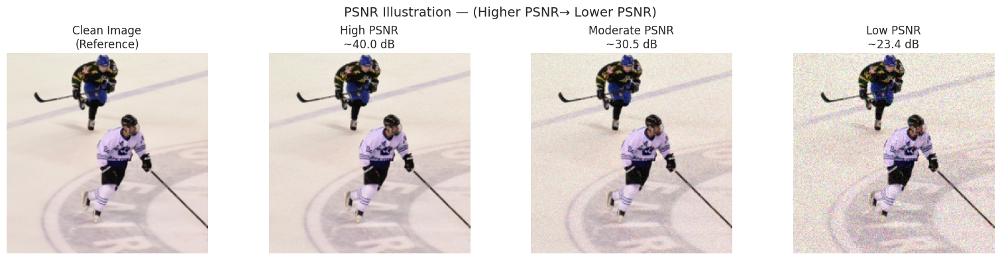

In [25]:
import matplotlib.pyplot as plt
import numpy as np
from skimage.metrics import peak_signal_noise_ratio as psnr

# Pick one image from your dataset (loaded in pixel space [0,1])
image_id = images_df["ImageId"].sample(1, random_state=123).item()
pil, x0 = load_image_pix(image_id)  # x0: [1,C,H,W] in [0,1]
x0_np = x0.squeeze(0).permute(1, 2, 0).cpu().numpy()  # [H,W,C] for visualization

# Add Gaussian noise with different std values
def add_noise(image_np, std):
    noise = np.random.normal(0, std, image_np.shape)
    return np.clip(image_np + noise, 0, 1)

std_levels = [0.01, 0.03, 0.07]
noisy_images = [add_noise(x0_np, s) for s in std_levels]
psnr_vals = [psnr(x0_np, noisy, data_range=1.0) for noisy in noisy_images]

# Plot clean + 3 noisy variants with PSNR labels
fig, axes = plt.subplots(1, 4, figsize=(16, 4))
axes[0].imshow(x0_np)
axes[0].set_title("Clean Image\n(Reference)")
axes[0].axis("off")

titles = [
    f"High PSNR\n~{psnr_vals[0]:.1f} dB",
    f"Moderate PSNR\n~{psnr_vals[1]:.1f} dB",
    f"Low PSNR\n~{psnr_vals[2]:.1f} dB"
]

for i, ax in enumerate(axes[1:]):
    ax.imshow(noisy_images[i])
    ax.set_title(titles[i])
    ax.axis("off")

fig.suptitle("PSNR Illustration — (Higher PSNR→ Lower PSNR)", fontsize=14)
plt.tight_layout()
plt.show()


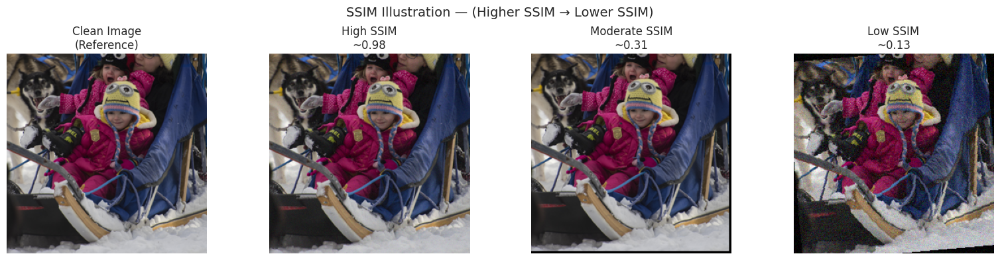

✅ Saved: bilder/SSIMIllustration.png


In [26]:
# === SSIM Illustration (Save to bilder/SSIMIllustration.png) ===

from PIL import Image, ImageFilter
import numpy as np
import matplotlib.pyplot as plt
from skimage.metrics import structural_similarity as ssim
import os

# 1. Load clean image (use a sample from the dataset)
image_id = images_df["ImageId"].sample(1, random_state=11).item()
img_path = os.path.join(dataset_path, "images", f"{image_id}.png")
clean = Image.open(img_path).convert("RGB").resize((256, 256))

# 2. Generate variations
noise_low = clean.copy()
noise_low_np = np.array(noise_low).astype(np.float32) / 255.0
noise_low_np += np.random.normal(0, 0.01, noise_low_np.shape)  # low noise
noise_low_np = np.clip(noise_low_np, 0, 1)
noise_low = Image.fromarray((noise_low_np * 255).astype(np.uint8))

shifted = clean.transform(clean.size, Image.AFFINE, (1, 0, 3, 0, 1, 3), resample=Image.BILINEAR)

noisy_rotated_np = np.array(clean.rotate(5)).astype(np.float32) / 255.0
noisy_rotated_np += np.random.normal(0, 0.05, noisy_rotated_np.shape)  # strong noise
noisy_rotated_np = np.clip(noisy_rotated_np, 0, 1)
noisy_rotated = Image.fromarray((noisy_rotated_np * 255).astype(np.uint8))

# 3. Compute SSIM values
def get_ssim(im1, im2):
    arr1 = np.array(im1).astype(np.float32) / 255.0
    arr2 = np.array(im2).astype(np.float32) / 255.0
    return ssim(arr1, arr2, channel_axis=-1, data_range=1.0)

ssim_high = get_ssim(clean, noise_low)
ssim_mod  = get_ssim(clean, shifted)
ssim_low  = get_ssim(clean, noisy_rotated)

# 4. Plot
fig, axes = plt.subplots(1, 4, figsize=(16, 4))
images = [clean, noise_low, shifted, noisy_rotated]
titles = [
    "Clean Image\n(Reference)",
    f"High SSIM\n~{ssim_high:.2f}",
    f"Moderate SSIM\n~{ssim_mod:.2f}",
    f"Low SSIM\n~{ssim_low:.2f}"
]

for ax, img, title in zip(axes, images, titles):
    ax.imshow(img)
    ax.set_title(title)
    ax.axis("off")

fig.suptitle("SSIM Illustration — (Higher SSIM → Lower SSIM)", fontsize=14)
plt.tight_layout()
plt.subplots_adjust(top=0.8)

# Save to bilder folder
os.makedirs("bilder", exist_ok=True)
fig.savefig("bilder/SSIMIllustration.png", dpi=300, bbox_inches="tight", facecolor="white")
plt.show()
print("✅ Saved: bilder/SSIMIllustration.png")


/tmp/ipython-input-3179311893.py:71: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0.02, 0.02, 0.9, 0.95])


✅ Saved figure to: bilder/L2Illustration_WithHeatmap.png


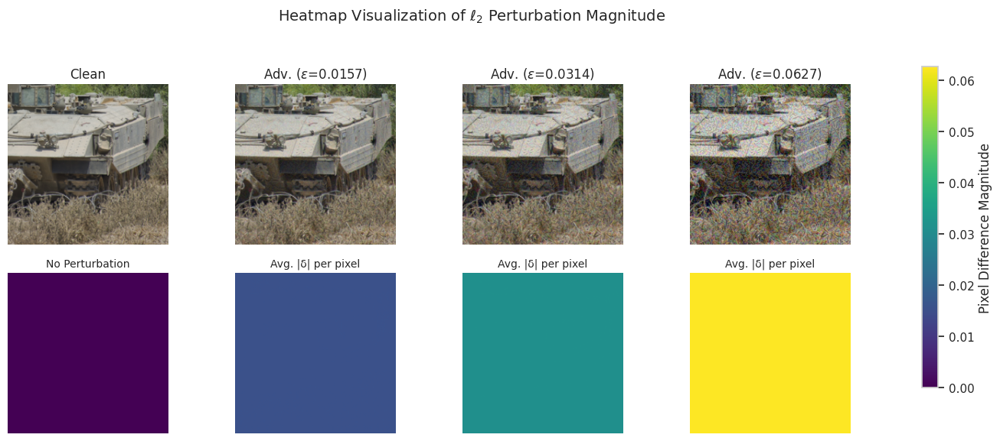

In [27]:
import torch
import numpy as np
import matplotlib.pyplot as plt

# === Utility: convert [1,C,H,W] image tensor to [H,W,C] in [0,1] ===
def _np_img(x_1chw: torch.Tensor) -> np.ndarray:
    """Convert a [1,C,H,W] tensor in [0,1] to a HxWxC numpy image for display."""
    return x_1chw.detach().clamp(0,1).squeeze(0).permute(1,2,0).cpu().numpy()

# === Main Function: Generate and save L2 heatmap figure ===
def plot_l2_difference_heatmaps(
    image_id: str,
    epsilons: list = [4/255, 8/255, 16/255],
    attack_fn=fgsm_pixel,
    save_path="bilder/L2Illustration_WithHeatmap.png",
    show=True
):
    """
    Generate L2 difference heatmaps between a clean image and adversarial versions.
    Each ε yields:
      - Row 1: adversarial image
      - Row 2: per-pixel |δ| averaged over RGB channels (for heatmap)
    """

    # --- Load clean image and label ---
    pil, x0 = load_image_pix(image_id)
    y0 = int(images_df.loc[images_df["ImageId"] == image_id, "TrueLabel0"].values[0])
    y_true = torch.tensor([y0], dtype=torch.long, device=x0.device)

    # --- Generate adversarial images and compute differences ---
    adv_images = []
    diff_maps = []
    for eps in epsilons:
        x_adv = attack_fn(model, x0, y_true, eps)  # Adversarial image
        adv_images.append(x_adv)

        # Per-pixel average difference over channels
        diff = (x_adv - x0).abs().squeeze(0).mean(dim=0).cpu().numpy()  # [H,W]
        diff_maps.append(diff)

    # --- Plotting ---
    n = len(epsilons)
    fig, axes = plt.subplots(2, n+1, figsize=(3.5*(n+1), 6))

    # First column = clean image + zero heatmap
    axes[0,0].imshow(_np_img(x0))
    axes[0,0].set_title("Clean", fontsize=12)
    axes[0,0].axis("off")

    axes[1,0].imshow(np.zeros_like(diff_maps[0]), cmap="viridis")
    axes[1,0].set_title("No Perturbation", fontsize=10)
    axes[1,0].axis("off")

    vmax = max([np.max(diff) for diff in diff_maps])

    # Remaining columns = adversarial + heatmap
    for i, (eps, x_adv, diff) in enumerate(zip(epsilons, adv_images, diff_maps), start=1):
        axes[0,i].imshow(_np_img(x_adv))
        axes[0,i].set_title(f"Adv. ($\\epsilon$={eps:.4f})", fontsize=12)
        axes[0,i].axis("off")

        im = axes[1,i].imshow(diff, cmap="viridis", vmin=0, vmax=vmax)
        axes[1,i].set_title("Avg. |δ| per pixel", fontsize=10)
        axes[1,i].axis("off")

    # Colorbar (right side)
    cbar_ax = fig.add_axes([0.92, 0.15, 0.015, 0.7])
    fig.colorbar(im, cax=cbar_ax, label="Pixel Difference Magnitude")

    plt.suptitle(r"Heatmap Visualization of $\ell_2$ Perturbation Magnitude", fontsize=14)
    plt.tight_layout(rect=[0.02, 0.02, 0.9, 0.95])

    if save_path:
        plt.savefig(save_path, dpi=300, bbox_inches="tight", facecolor="white")
        print(f"✅ Saved figure to: {save_path}")
    if show:
        plt.show()

# === Run the function on a random sample image ===
demo_id = images_df["ImageId"].sample(1, random_state=33).item()

plot_l2_difference_heatmaps(
    image_id=demo_id,
    epsilons=[4/255, 8/255, 16/255],
    attack_fn=fgsm_pixel,  # use your own attack function here
    save_path="bilder/L2Illustration_WithHeatmap.png",
    show=True
)


Evaluating FGSM Attack...


/usr/local/lib/python3.12/dist-packages/skimage/metrics/simple_metrics.py:168: RuntimeWarning: divide by zero encountered in scalar divide
  return 10 * np.log10((data_range**2) / err)


Evaluating BIM Attack...
Evaluating PGD Attack...

Comparison Table of Adversarial Attacks:

   Attack   Epsilon  Success Rate (%)  Avg L2 Norm  Avg SSIM   Avg PSNR
0    FGSM  0.000000              15.5     0.000000  1.000000        inf
1    FGSM  0.015686              92.0     6.029372  0.920262  36.173705
2    FGSM  0.031373              90.5    12.010108  0.776669  30.189114
3    FGSM  0.047059              88.5    17.948763  0.651403  26.700214
4    FGSM  0.062745              88.5    23.840225  0.554141  24.235477
5     BIM  0.000000              15.5     0.000000  1.000000        inf
6     BIM  0.015686              97.0     1.518476  0.994693  48.158829
7     BIM  0.031373             100.0     3.656060  0.970270  40.523475
8     BIM  0.047059             100.0     6.197167  0.921462  35.937195
9     BIM  0.062745             100.0     8.074624  0.877356  33.636735
10    PGD  0.000000              15.5     0.000000  1.000000        inf
11    PGD  0.015686              98.0     3

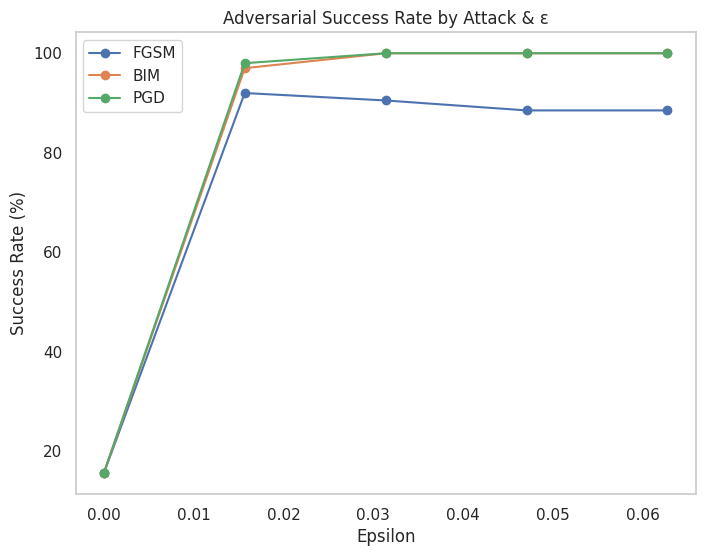

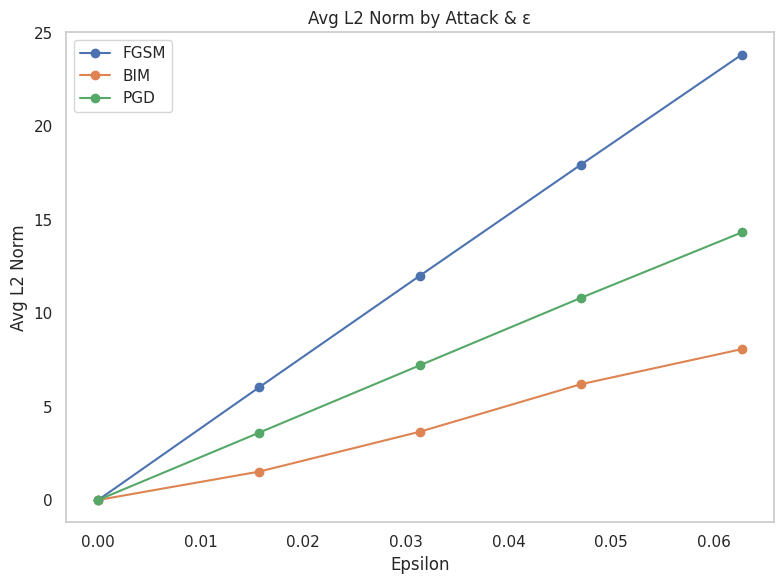

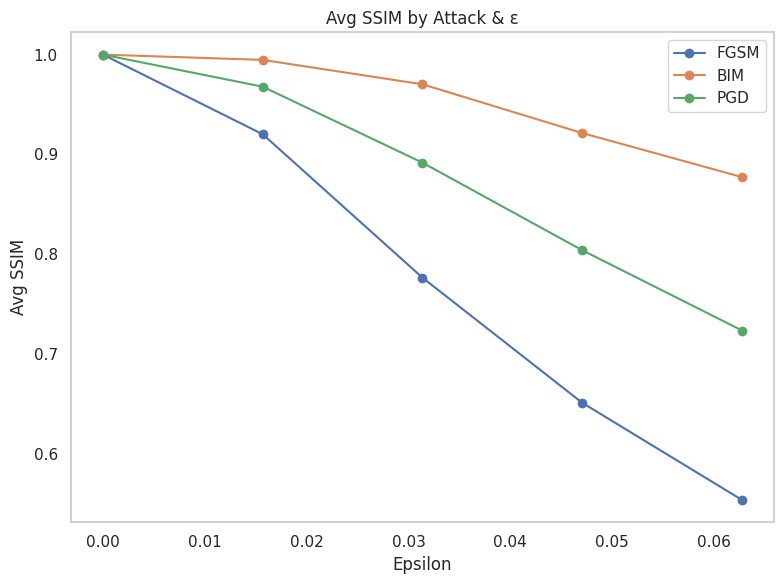

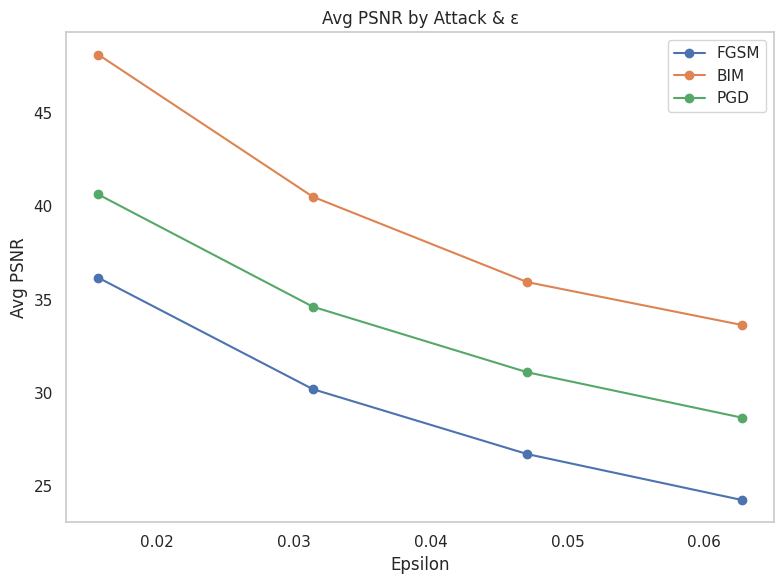

In [28]:
# ─── Wrapper‐based attack functions ─────────────────────────────────────────────
attack_fns = {
    'FGSM': lambda model, x_pix, y, eps: fgsm_pixel(model, x_pix, y, eps),
    'BIM':  lambda model, x_pix, y, eps: (lambda a_s: bim_pixel(model, x_pix, y, eps, alpha=a_s[0], steps=a_s[1]))(sched(eps)),
    'PGD':  lambda model, x_pix, y, eps: (lambda a_s: pgd_pixel_no_restarts(model, x_pix, y, eps, alpha=a_s[0], steps=a_s[1]))(sched(eps)),
}



# ─── Revised evaluate_attacks using the unified interface ────────────────────────
def evaluate_attacks(model, original_images, labels, attack_functions, epsilons):
    model.eval()
    device = next(model.parameters()).device
    X = original_images.to(device)   # pixels in [0,1]
    Y = labels.to(device)
    results = []

    for attack_name, attack_fn in attack_functions.items():
        print(f"Evaluating {attack_name} Attack...")
        for eps in epsilons:
            success = 0
            l2_diffs, ssim_scores, psnr_scores = [], [], []

            for x0, y in zip(X, Y):
                x0 = x0.unsqueeze(0)  # [1,C,H,W]

                # generate adversarial in pixel space (uses true-label CE)
                x_adv = attack_fn(model, x0, y.unsqueeze(0), eps)

                # success vs true label (normalize inside fwd)
                pred = fwd_logits(model, x_adv).argmax(dim=1).item()
                success += int(pred != y.item())

                # metrics on pixels
                diff = (x_adv - x0).view(1, -1)
                l2_diffs.append(torch.norm(diff, p=2).item())

                orig_np = x0.squeeze().permute(1,2,0).detach().cpu().numpy()
                adv_np  = x_adv.squeeze().permute(1,2,0).detach().cpu().numpy()
                ssim_scores.append(ssim(orig_np, adv_np, data_range=1.0, channel_axis=-1))
                psnr_scores.append(psnr(orig_np, adv_np, data_range=1.0))

            N = len(Y)
            results.append({
                "Attack": attack_name,
                "Epsilon": float(eps),
                "Success Rate (%)": float(100.0 * success / N),
                "Avg L2 Norm": float(np.mean(l2_diffs)),
                "Avg SSIM":   float(np.mean(ssim_scores)),
                "Avg PSNR":   float(np.mean(psnr_scores)),
            })
    return pd.DataFrame(results)

# ─── Prepare the 150‐image pilot set ───────────────────────────────────────────────
# `image_ids` was defined in Cell 7.2.1 as your stratified 150 IDs
# === STEP 3B: build pixel-space tensors for comparative analysis ===
original_images = torch.cat([ load_image_pix(img_id)[1] for img_id in image_ids ], dim=0)  # [N,C,H,W] in [0,1]
labels = torch.tensor([ get_label0(img_id) for img_id in image_ids ],
                      dtype=torch.long).to(original_images.device)




# ─── Define the epsilons to test ────────────────────────────────────────────────
epsilons = [0, 4/255, 8/255, 12/255, 16/255]

# ─── Run the Comparative Evaluation ─────────────────────────────────────────────
df_results = evaluate_attacks(model, original_images, labels, attack_fns, epsilons)


# Display the results table
print("\nComparison Table of Adversarial Attacks:\n")
print(df_results)

# Plot Success Rate vs. Epsilon
plt.figure(figsize=(8, 6))
for attack in df_results["Attack"].unique():
    subset = df_results[df_results["Attack"] == attack]
    plt.plot(subset["Epsilon"], subset["Success Rate (%)"], marker='o', label=attack)
plt.xlabel("Epsilon")
plt.ylabel("Success Rate (%)")
plt.title("Adversarial Success Rate by Attack & ε")
plt.legend()
plt.grid()
plt.show()

# Plot additional metrics
metrics = ["Avg L2 Norm", "Avg SSIM", "Avg PSNR"]
for metric in metrics:
    plt.figure(figsize=(8, 6))
    for attack in df_results["Attack"].unique():
        subset = df_results[df_results["Attack"] == attack]
        plt.plot(subset["Epsilon"], subset[metric], marker='o', label=attack)
    plt.xlabel("Epsilon")
    plt.ylabel(metric)
    plt.title(f"{metric} by Attack & ε")
    plt.legend()
    plt.grid()
    plt.tight_layout()
    plt.show()